In [1]:
import numpy as np 
import pandas as pd
import cv2 
import matplotlib.pyplot as plt 
import pickle as pkl
%matplotlib inline

In [2]:
import albumentations as A


In [3]:
def get_annot(annot_path = 'dataset/LEs920/ann.txt'):
    """get annotation from dataset text"""
    with open(annot_path, 'r') as f:
        txt = f.readlines()
        annotations = [line.strip() for line in txt if len(line.strip().split()[1:]) != 0]
    resdic = {}
    for ann in annotations:
        ann = ann.split(' ')
        image_path = ann[0]
        boxarr = []
        for a in ann[1:]:
            box = np.fromstring(a, sep=',')
            boxarr.append(box)
        boxarr = np.array(boxarr)
        resdic[image_path] = boxarr

    return resdic


In [4]:
def random_colors(N, bright=True):
    '''
    Generate random colors.
    To get visually distinct colors, generate them in HSV space then
    convert to RGB.
    '''
    import random
    import colorsys

    brightness = 1.0 if bright else 0.7
    hsv = [(i / N, 1, brightness) for i in range(N)]
    colors = list(map(lambda c: colorsys.hsv_to_rgb(*c), hsv))
    random.shuffle(colors)
    return colors


In [5]:
def draw_boxes(bboxes, labels=[], ax=None, colors=None):
    """draw bounding box on a given ax, [N, x1, y1, x2, y2]"""
    import random
    import matplotlib.pyplot as plt
    from matplotlib import patches
    
    #N = bboxes.shape[0]  
    N = len( bboxes )
    if colors == None:
        colors = random_colors(N)
    else: 
        colors = [colors]*N

    for i in range(N):
        # for faster rcnn
        #y1, x1, y2, x2 = bboxes[i] [:4]
        #y1, x1, y2, x2 = int(y1), int(x1), int(y2), int(x2)    
        # for yolo
        x1, y1, x2, y2 = bboxes[i][:4]
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)

        p = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2,
                              alpha=0.7, linestyle="dashed",
                              edgecolor=colors[i], facecolor='none')
        ax.add_patch(p)

        # Label
        #class_id = class_ids[i]
        #score = scores[i] if scores is not None else None
        #label = class_names[class_id]
        x = random.randint(x1, (x1 + x2) // 2)
        if len(labels)!=0:
            caption = "{:.2f}".format( labels[i] )
            ax.text(x2 - 8, y1, caption,
                    color='w', size=10, backgroundcolor="none") 
    



In [17]:
anndic = get_annot("dataset/LE_cand1/LE_all.txt")
anndic = get_annot("dataset/LE_cand1/train_aug.txt")

In [18]:
imgfiles = list( anndic.keys() )

In [19]:
len(imgfiles)

168

In [22]:
imgfiles

['./dataset/LE_cand1/tiles_aug/001_2.jpg',
 './dataset/LE_cand1/tiles_aug/001_2_fliph.jpg',
 './dataset/LE_cand1/tiles_aug/001_2_fliph_r180.jpg',
 './dataset/LE_cand1/tiles_aug/001_2_fliph_r270.jpg',
 './dataset/LE_cand1/tiles_aug/001_2_fliph_r90.jpg',
 './dataset/LE_cand1/tiles_aug/001_2_r180.jpg',
 './dataset/LE_cand1/tiles_aug/001_2_r270.jpg',
 './dataset/LE_cand1/tiles_aug/001_2_r90.jpg',
 './dataset/LE_cand1/tiles_aug/002_1.jpg',
 './dataset/LE_cand1/tiles_aug/002_1_fliph.jpg',
 './dataset/LE_cand1/tiles_aug/002_1_fliph_r180.jpg',
 './dataset/LE_cand1/tiles_aug/002_1_fliph_r270.jpg',
 './dataset/LE_cand1/tiles_aug/002_1_fliph_r90.jpg',
 './dataset/LE_cand1/tiles_aug/002_1_r180.jpg',
 './dataset/LE_cand1/tiles_aug/002_1_r270.jpg',
 './dataset/LE_cand1/tiles_aug/002_1_r90.jpg',
 './dataset/LE_cand1/tiles_aug/002_2.jpg',
 './dataset/LE_cand1/tiles_aug/002_2_fliph.jpg',
 './dataset/LE_cand1/tiles_aug/002_2_fliph_r180.jpg',
 './dataset/LE_cand1/tiles_aug/002_2_fliph_r270.jpg',
 './data

In [8]:
imgpath = imgfiles[0]
img = cv2.imread(imgpath, cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


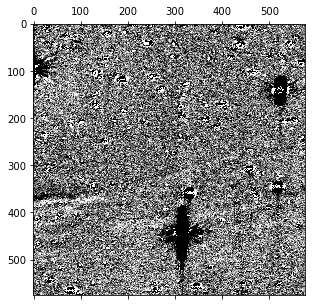

In [9]:
fig, ax = plt.subplots(1, figsize=(5,5))

ax.matshow(img, cmap='gray');

#draw_boxes(a, ax=ax, colors='r')
#draw_boxes(b, ax=ax, colors='w')

In [10]:
bboxes = anndic [ imgpath]

draw_boxes(bboxes, labels=bboxes[:, 4], ax=ax)

In [11]:
bboxes

array([[180., 403., 293., 425.,   0.],
       [266., 304., 340., 332.,   0.],
       [498., 106., 556., 187.,   1.],
       [272., 376., 366., 528.,   1.],
       [501., 327., 541., 367.,   1.],
       [315., 342., 347., 374.,   1.],
       [  1., 353., 110., 384.,   0.],
       [  0.,  61.,  47., 133.,   1.],
       [ 67., 553.,  91., 575.,   1.],
       [334., 544., 360., 570.,   1.],
       [368., 372., 461., 405.,   0.]])

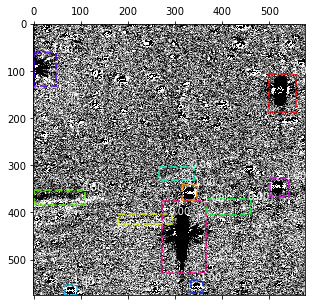

In [12]:
fig

In [16]:
imgfiles

['./dataset/LE_cand1/tiles/005_8.jpg',
 './dataset/LE_cand1/tiles/009_8.jpg',
 './dataset/LE_cand1/tiles/003_2.jpg',
 './dataset/LE_cand1/tiles/010_6.jpg',
 './dataset/LE_cand1/tiles/014_1.jpg',
 './dataset/LE_cand1/tiles/018_1.jpg',
 './dataset/LE_cand1/tiles/001_2.jpg',
 './dataset/LE_cand1/tiles/014_0.jpg',
 './dataset/LE_cand1/tiles/003_4.jpg',
 './dataset/LE_cand1/tiles/006_7.jpg',
 './dataset/LE_cand1/tiles/013_5.jpg',
 './dataset/LE_cand1/tiles/017_3.jpg',
 './dataset/LE_cand1/tiles/006_6.jpg',
 './dataset/LE_cand1/tiles/002_1.jpg',
 './dataset/LE_cand1/tiles/017_0.jpg',
 './dataset/LE_cand1/tiles/004_4.jpg',
 './dataset/LE_cand1/tiles/006_5.jpg',
 './dataset/LE_cand1/tiles/002_2.jpg',
 './dataset/LE_cand1/tiles/011_6.jpg',
 './dataset/LE_cand1/tiles/007_0.jpg',
 './dataset/LE_cand1/tiles/006_4.jpg',
 './dataset/LE_cand1/tiles/015_0.jpg',
 './dataset/LE_cand1/tiles/008_5.jpg',
 './dataset/LE_cand1/tiles/012_2.jpg',
 './dataset/LE_cand1/tiles/016_2.jpg',
 './dataset/LE_cand1/tile

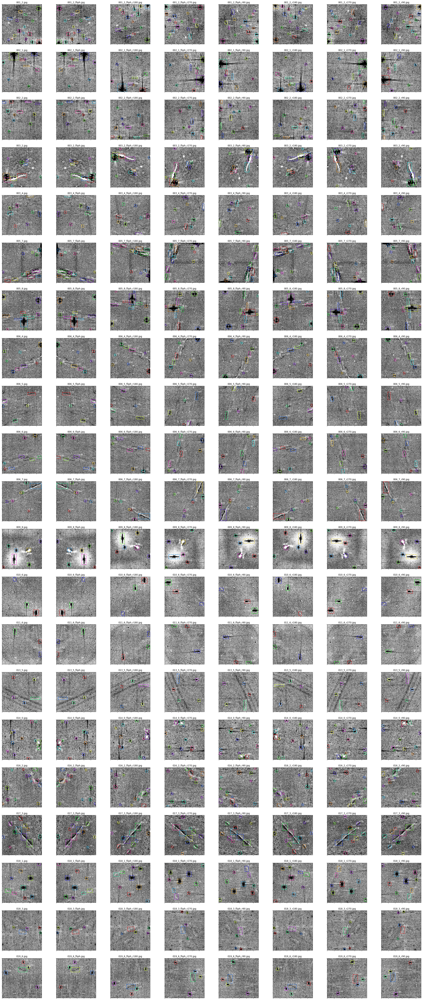

In [39]:

fig, axs = plt.subplots(21, 8, figsize=(40, 12*4 *2) ) # trainset

#fig, axs = plt.subplots(9, 8, figsize=(40, 12*4) ) # testset

axs = axs.flatten()
for i, imgpath in enumerate( imgfiles ) :

    ax = axs[i]

    ax.set_title( imgpath.split('/')[-1] )
    
    img = cv2.imread(imgpath, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax.imshow(img)
    
    # plot labeled boxes
    bboxes = anndic [ imgpath ]
    #draw_boxes(bboxes, labels=bboxes[:, 4], ax=ax, colors='white')
    
    draw_boxes(bboxes, labels=bboxes[:, 4], ax=ax,)

    ax.set_xticklabels([])
    ax.set_yticklabels([])
    #if nTP_recall < nAnn:
    #    [sp.set_color('r') for sp in ax.spines.values()]
    #    [sp.set_linewidth(3) for sp in ax.spines.values()]



### define augmentation pipeline

In [48]:
A.Rotate?

In [184]:
transform = A.Compose( [A.Rotate(limit=[45,45], p=1) ], 
                      bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']) 
                     )




In [185]:
imgfile = imgfiles[0]
fitspath = imgfile.replace('jpg', 'fits.npz')
fitsarr = np.load(fitspath)['fitsarr']

# normalize fits
#fitsarr = (fitsarr - fitsarr.mean() ) / fitsarr.std()

fitsarr = np.clip(fitsarr, a_max=1, a_min=-1)

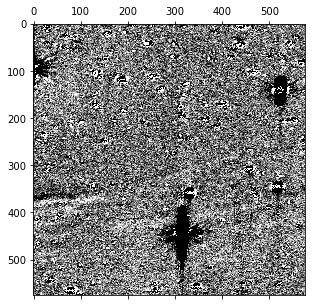

In [186]:
fig, ax = plt.subplots(1, figsize=(5,5))

ax.matshow( fitsarr, cmap='gray');

#draw_boxes(transformed['bboxes'], ax=ax,)

In [167]:
fitsarr.min()

-1.0

In [187]:
#transformed = transform(image=img/255-4, bboxes=bboxes, 
#                        class_labels=bboxes[:,4])
transformed = transform(image=fitsarr, bboxes=bboxes, 
                        class_labels=bboxes[:,4])



In [188]:
transformed.keys()

dict_keys(['image', 'bboxes', 'class_labels'])

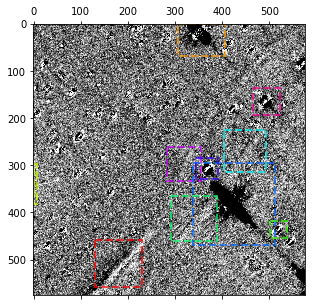

In [189]:
fig, ax = plt.subplots(1, figsize=(5,5))

ax.matshow( transformed['image'], cmap='gray');

draw_boxes(transformed['bboxes'], ax=ax,)

### Cutout mixup

In [193]:
def bbox_ioa(box1, box2, eps=1E-7):
    """ Returns the intersection over box2 area given box1, box2. Boxes are x1y1x2y2
    box1:       np.array of shape(4)
    box2:       np.array of shape(nx4)
    returns:    np.array of shape(n)
    """

    box2 = box2.transpose()

    # Get the coordinates of bounding boxes
    b1_x1, b1_y1, b1_x2, b1_y2 = box1[0], box1[1], box1[2], box1[3]
    b2_x1, b2_y1, b2_x2, b2_y2 = box2[0], box2[1], box2[2], box2[3]

    # Intersection area
    inter_area = (np.minimum(b1_x2, b2_x2) - np.maximum(b1_x1, b2_x1)).clip(0) * \
                 (np.minimum(b1_y2, b2_y2) - np.maximum(b1_y1, b2_y1)).clip(0)

    # box2 area
    box2_area = (b2_x2 - b2_x1) * (b2_y2 - b2_y1) + eps

    # Intersection over box2 area
    return inter_area / box2_area


In [191]:
scales = [0.5] * 1 + [0.25] * 2 + [0.125] * 4 + [0.0625] * 8 + [0.03125] * 16  # image size fraction



In [194]:
import random

def cutout(im, labels, p=0.5):
    # Applies image cutout augmentation https://arxiv.org/abs/1708.04552
    if random.random() < p:
        h, w = im.shape[:2]
        scales = [0.5] * 1 + [0.25] * 2 + [0.125] * 4 + [0.0625] * 8 + [0.03125] * 16  # image size fraction
        for s in scales:
            mask_h = random.randint(1, int(h * s))  # create random masks
            mask_w = random.randint(1, int(w * s))

            # box
            xmin = max(0, random.randint(0, w) - mask_w // 2)
            ymin = max(0, random.randint(0, h) - mask_h // 2)
            xmax = min(w, xmin + mask_w)
            ymax = min(h, ymin + mask_h)

            # apply random color mask
            im[ymin:ymax, xmin:xmax] = [random.randint(64, 191) for _ in range(3)]

            # return unobscured labels
            if len(labels) and s > 0.03:
                box = np.array([xmin, ymin, xmax, ymax], dtype=np.float32)
                ioa = bbox_ioa(box, labels[:, 1:5])  # intersection over area
                labels = labels[ioa < 0.60]  # remove >60% obscured labels

    return labels

def mixup(im, labels, im2, labels2):
    # Applies MixUp augmentation https://arxiv.org/pdf/1710.09412.pdf
    r = np.random.beta(32.0, 32.0)  # mixup ratio, alpha=beta=32.0
    im = (im * r + im2 * (1 - r)).astype(np.uint8)
    labels = np.concatenate((labels, labels2), 0)
    return im, labels


In [216]:
imgpath = imgfiles[0]
img = cv2.imread(imgpath, cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
annot = anndic[imgpath]

imgpath2 = imgfiles[2]
img2 = cv2.imread(imgpath2, cv2.IMREAD_COLOR)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
annot2 = anndic[imgpath2]


In [227]:
img_mix, label_mix = mixup(img, annot, img2, annot2)


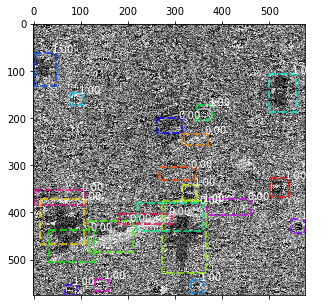

In [228]:
fig, ax = plt.subplots(1, figsize=(5,5))

ax.matshow(img_mix, cmap='gray');
bboxes = annot
draw_boxes(label_mix, labels=label_mix[:, 4], ax=ax)

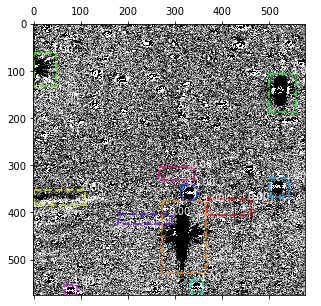

In [207]:
fig, ax = plt.subplots(1, figsize=(5,5))

ax.matshow(img, cmap='gray');
bboxes = annot
draw_boxes(bboxes, labels=bboxes[:, 4], ax=ax)

In [203]:
cutout(img, annot)

array([[180., 403., 293., 425.,   0.],
       [266., 304., 340., 332.,   0.],
       [498., 106., 556., 187.,   1.],
       [272., 376., 366., 528.,   1.],
       [501., 327., 541., 367.,   1.],
       [315., 342., 347., 374.,   1.],
       [  1., 353., 110., 384.,   0.],
       [  0.,  61.,  47., 133.,   1.],
       [ 67., 553.,  91., 575.,   1.],
       [334., 544., 360., 570.,   1.],
       [368., 372., 461., 405.,   0.]])